
Processing model: pythia-70m
Loaded entropy_diff data for Language layer 0
Loaded delta_p_flip data for Language layer 0
Loaded unique_ratio_steered data for Language layer 0
Loaded entropy_diff data for Language layer 1
Loaded delta_p_flip data for Language layer 1
Loaded unique_ratio_steered data for Language layer 1
Loaded entropy_diff data for Language layer 2
Loaded delta_p_flip data for Language layer 2
Loaded unique_ratio_steered data for Language layer 2
Loaded entropy_diff data for Language layer 3
Loaded delta_p_flip data for Language layer 3
Loaded unique_ratio_steered data for Language layer 3
Loaded entropy_diff data for Language layer 4
Loaded delta_p_flip data for Language layer 4
Loaded unique_ratio_steered data for Language layer 4
Loaded entropy_diff data for Safety layer 0
Loaded delta_p_flip data for Safety layer 0
Loaded unique_ratio_steered data for Safety layer 0
Loaded entropy_diff data for Safety layer 1
Loaded delta_p_flip data for Safety layer 1
Loaded uniqu

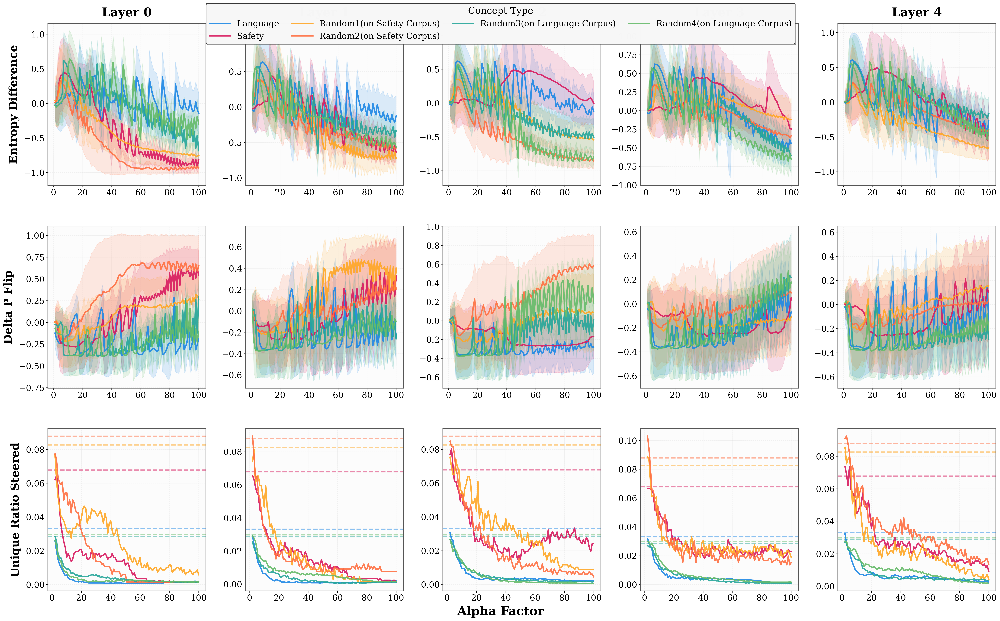

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import torch

# Set publication-quality style with enhanced aesthetics
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 22
plt.rcParams['axes.titlesize'] = 24
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams['legend.fontsize'] = 16
plt.rcParams['figure.titlesize'] = 26
plt.rcParams['axes.linewidth'] = 1.5
plt.rcParams['grid.linewidth'] = 0.6
plt.rcParams['lines.linewidth'] = 2.5
plt.rcParams['axes.facecolor'] = '#FAFAFA'
plt.rcParams['figure.facecolor'] = 'white'

# Define models and their layer counts
models = {
    'pythia-70m': 6,
    # 'pythia-160m': 12
}

# Define a sophisticated color palette with better contrast
colors = {
    'Language': '#1E88E5',    # Vibrant blue
    'Safety': '#D81B60',      # Rich pink/magenta
    'Random': '#FFA726',      # Warm orange
    'Random1': '#FF7043',     # Coral orange
    'Random2': '#26A69A',     # Teal
    'Random3': '#66BB6A'      # Green
}

concept_dict = {
    'Language': 'Language',
    'Safety': 'Safety',
    'Random': 'Random1(on Safety Corpus)',
    'Random1': 'Random2(on Safety Corpus)',
    'Random2': 'Random3(on Language Corpus)',
    'Random3': 'Random4(on Language Corpus)'
}

concept_categories = ['language_en_fr', 'safety', 'random', 'random1', 'random2', 'random3']
concept_names = ['Language', 'Safety', 'Random', 'Random1', 'Random2', 'Random3']

# Define the six metrics to plot
metrics = ['entropy_diff', 'delta_p_flip', 'unique_ratio_steered']
metric_labels = {
    'entropy_diff': 'Entropy Difference',
    'delta_p_flip': 'Delta P Flip',
    'delta_tail': 'Delta Tail',
    'norm_diff': 'Norm Difference',
    'unique_ratio_steered': 'Unique Ratio Steered',
    'unique_ratio_wo_steering': 'Unique Ratio W/O Steering'
}

# Create figure with 6 rows x number of layers columns
for model_name, num_layers in models.items():
    print(f"\nProcessing model: {model_name}")
    # Create a figure with subplots: 3 rows (one per metric) x (num_layers-1) columns
    fig, axes = plt.subplots(3, num_layers - 1, figsize=(6 * (num_layers - 1), 18), dpi=300)
    
    # Load norm results for all concepts and layers
    norm_results = {}
    for concept_cat, concept_name in zip(concept_categories, concept_names):
        norm_results[concept_name] = {metric: {'mean': [], 'std': []} for metric in metrics}
        for layer_idx in range(num_layers-1):
            norm_path = f"../../assets/linearity/{model_name}/norm_related_{concept_cat}_layer{layer_idx}.pt"
            try:
                norm_data = torch.load(norm_path)
                # Extract mean and std for each metric from the norm_related dictionary
                for metric in metrics:
                    mean_key = f"{metric}_mean"
                    std_key = f"{metric}_std"
                    if mean_key in norm_data and std_key in norm_data:
                        norm_results[concept_name][metric]['mean'].append(np.array(norm_data[mean_key]))
                        norm_results[concept_name][metric]['std'].append(np.array(norm_data[std_key]))
                        print(f"Loaded {metric} data for {concept_name} layer {layer_idx}")
                    elif metric in ['unique_ratio_steered', 'unique_ratio_wo_steering']:
                        # For unique ratio metrics, there's no std, just the values themselves
                        if metric in norm_data:
                            norm_results[concept_name][metric]['mean'].append(np.array(norm_data[metric]))
                            norm_results[concept_name][metric]['std'].append(np.zeros_like(np.array(norm_data[metric])))
                            print(f"Loaded {metric} data for {concept_name} layer {layer_idx}")
                        else:
                            print(f"Missing {metric} data in norm_related for {concept_name} layer {layer_idx}")
                            # Create dummy data if metric doesn't exist
                            alpha_factor = 100
                            norm_results[concept_name][metric]['mean'].append(np.zeros(alpha_factor))
                            norm_results[concept_name][metric]['std'].append(np.zeros(alpha_factor))
                    else:
                        print(f"Missing {metric} data in norm_related for {concept_name} layer {layer_idx}")
                        # Create dummy data if metric doesn't exist
                        alpha_factor = 100
                        norm_results[concept_name][metric]['mean'].append(np.zeros(alpha_factor))
                        norm_results[concept_name][metric]['std'].append(np.zeros(alpha_factor))
            except Exception as e:
                print(f"Error loading norm_related data for {concept_name} layer {layer_idx}: {e}")
                # Create dummy data if file doesn't exist
                alpha_factor = 100
                for metric in metrics:
                    norm_results[concept_name][metric]['mean'].append(np.zeros(alpha_factor))
                    norm_results[concept_name][metric]['std'].append(np.zeros(alpha_factor))
    
    # Get alpha values (from 100 to 100000)
    alpha_factor = len(norm_results[concept_names[0]][metrics[0]]['mean'][0])
    alpha_values = np.linspace(1, 100, alpha_factor)
    
    # Plot each metric in a separate row
    for metric_idx, metric in enumerate(metrics):
        for layer_idx in range(num_layers-1):
            ax = axes[metric_idx, layer_idx]
            
            # For unique_ratio_steered, plot the baseline (first value) for each concept
            if metric == 'unique_ratio_steered':
                for concept_name in concept_names:
                    baseline_value = norm_results[concept_name][metric]['mean'][layer_idx][0]
                    ax.axhline(y=baseline_value, color=colors[concept_name], linestyle='--', 
                              linewidth=2.5, alpha=0.5, zorder=1)
            
            for concept_name in concept_names:
                mean_data = norm_results[concept_name][metric]['mean'][layer_idx]
                std_data = norm_results[concept_name][metric]['std'][layer_idx]
                
                # For unique_ratio_steered, skip the first value (baseline) when plotting
                if metric == 'unique_ratio_steered':
                    mean_data = mean_data[1:]
                    std_data = std_data[1:]
                    alpha_values_plot = alpha_values[1:]
                else:
                    alpha_values_plot = alpha_values
                
                # Plot mean line with enhanced styling
                ax.plot(alpha_values_plot, mean_data, 
                       color=colors[concept_name], 
                       label=concept_dict[concept_name], 
                       linewidth=3, alpha=0.9, zorder=2)
                
                # Add shaded area for std (only if std is non-zero)
                if np.any(std_data > 0):
                    ax.fill_between(alpha_values_plot, 
                                   mean_data - std_data, 
                                   mean_data + std_data,
                                   color=colors[concept_name], 
                                   alpha=0.15, zorder=1)
            
            # Enhanced grid styling
            ax.grid(True, alpha=0.25, linestyle='--', linewidth=0.8, color='#CCCCCC')
            ax.set_axisbelow(True)
            
            # Add title only for the first row with enhanced styling
            if metric_idx == 0:
                ax.set_title(f'Layer {layer_idx}', fontweight='bold', pad=15, fontsize=26)
            
            # Add y-label only for the first column with enhanced styling
            if layer_idx == 0:
                ax.set_ylabel(metric_labels[metric], fontweight='bold', fontsize=24, labelpad=10)
            
            # Enhanced spine styling
            for spine in ax.spines.values():
                spine.set_linewidth(1.5)
                spine.set_color('#555555')
            
            # Add subtle background
            ax.patch.set_facecolor('#FAFAFA')
            ax.patch.set_alpha(0.5)
    
    # Add a single shared x-axis label at the bottom center with enhanced styling
    fig.text(0.5, -0.01, 'Alpha Factor', ha='center', fontweight='bold', fontsize=26)
    
    # Create a single legend at the top of the figure with enhanced styling
    handles, labels = axes[0, 0].get_legend_handles_labels()
    legend = fig.legend(handles, labels, title='Concept Type', loc='upper center', 
                       bbox_to_anchor=(0.5, 1.01), ncol=4, frameon=True, 
                       fancybox=True, shadow=True, framealpha=0.98, 
                       edgecolor='#333333', fontsize=18, title_fontsize=20,
                       columnspacing=1.5, handlelength=2.5)
    legend.get_frame().set_linewidth(1.5)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.97, bottom=0.03, hspace=0.25, wspace=0.25)
    plt.savefig(f'../../assets/figs/linearity/{model_name}_all_metrics_by_layer.pdf', 
                format='pdf', bbox_inches='tight', dpi=300)
    plt.show()


In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import torch

# Set publication-quality style with enhanced aesthetics
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 22
plt.rcParams['axes.titlesize'] = 24
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams['legend.fontsize'] = 16
plt.rcParams['figure.titlesize'] = 26
plt.rcParams['axes.linewidth'] = 1.5
plt.rcParams['grid.linewidth'] = 0.6
plt.rcParams['lines.linewidth'] = 2.5
plt.rcParams['axes.facecolor'] = '#FAFAFA'
plt.rcParams['figure.facecolor'] = 'white'

# Define models and their layer counts
models = {
    'pythia-160m': 12
}

# Define a sophisticated color palette with better contrast
colors = {
    'Language': '#1E88E5',    # Vibrant blue
    'Safety': '#D81B60',      # Rich pink/magenta
    'Random': '#FFA726',      # Warm orange
    'Random1': '#FF7043',     # Coral orange
    'Random2': '#26A69A',     # Teal
    'Random3': '#66BB6A'      # Green
}

concept_dict = {
    'Language': 'Language',
    'Safety': 'Safety',
    'Random': 'Random1(on Safety Corpus)',
    'Random1': 'Random2(on Safety Corpus)',
    'Random2': 'Random3(on Language Corpus)',
    'Random3': 'Random4(on Language Corpus)'
}

concept_categories = ['language_en_fr', 'safety', 'random', 'random1', 'random2', 'random3']
concept_names = ['Language', 'Safety', 'Random', 'Random1', 'Random2', 'Random3']

# Define the six metrics to plot
metrics = ['entropy_diff', 'delta_p_flip', 'unique_ratio_steered']
metric_labels = {
    'entropy_diff': 'Entropy Difference',
    'delta_p_flip': 'Delta P Flip',
    'delta_tail': 'Delta Tail',
    'norm_diff': 'Norm Difference',
    'unique_ratio_steered': 'Unique Ratio Steered',
    'unique_ratio_wo_steering': 'Unique Ratio W/O Steering'
}

# Create figure with 6 rows x number of layers columns
for model_name, num_layers in models.items():
    print(f"\nProcessing model: {model_name}")
    # Create a figure with subplots: 3 rows (one per metric) x (num_layers-1) columns
    fig, axes = plt.subplots(3, num_layers - 1, figsize=(6 * (num_layers - 1), 18), dpi=300)
    
    # Load norm results for all concepts and layers
    norm_results = {}
    for concept_cat, concept_name in zip(concept_categories, concept_names):
        norm_results[concept_name] = {metric: {'mean': [], 'std': []} for metric in metrics}
        for layer_idx in range(num_layers-1):
            norm_path = f"../../assets/linearity/{model_name}/norm_related_{concept_cat}_layer{layer_idx}.pt"
            try:
                norm_data = torch.load(norm_path)
                # Extract mean and std for each metric from the norm_related dictionary
                for metric in metrics:
                    mean_key = f"{metric}_mean"
                    std_key = f"{metric}_std"
                    if mean_key in norm_data and std_key in norm_data:
                        norm_results[concept_name][metric]['mean'].append(np.array(norm_data[mean_key]))
                        norm_results[concept_name][metric]['std'].append(np.array(norm_data[std_key]))
                        print(f"Loaded {metric} data for {concept_name} layer {layer_idx}")
                    elif metric in ['unique_ratio_steered', 'unique_ratio_wo_steering']:
                        # For unique ratio metrics, there's no std, just the values themselves
                        if metric in norm_data:
                            norm_results[concept_name][metric]['mean'].append(np.array(norm_data[metric]))
                            norm_results[concept_name][metric]['std'].append(np.zeros_like(np.array(norm_data[metric])))
                            print(f"Loaded {metric} data for {concept_name} layer {layer_idx}")
                        else:
                            print(f"Missing {metric} data in norm_related for {concept_name} layer {layer_idx}")
                            # Create dummy data if metric doesn't exist
                            alpha_factor = 100
                            norm_results[concept_name][metric]['mean'].append(np.zeros(alpha_factor))
                            norm_results[concept_name][metric]['std'].append(np.zeros(alpha_factor))
                    else:
                        print(f"Missing {metric} data in norm_related for {concept_name} layer {layer_idx}")
                        # Create dummy data if metric doesn't exist
                        alpha_factor = 100
                        norm_results[concept_name][metric]['mean'].append(np.zeros(alpha_factor))
                        norm_results[concept_name][metric]['std'].append(np.zeros(alpha_factor))
            except Exception as e:
                print(f"Error loading norm_related data for {concept_name} layer {layer_idx}: {e}")
                # Create dummy data if file doesn't exist
                alpha_factor = 100
                for metric in metrics:
                    norm_results[concept_name][metric]['mean'].append(np.zeros(alpha_factor))
                    norm_results[concept_name][metric]['std'].append(np.zeros(alpha_factor))
    
    # Get alpha values (from 100 to 100000)
    alpha_factor = len(norm_results[concept_names[0]][metrics[0]]['mean'][0])
    alpha_values = np.linspace(1, 100, alpha_factor)
    
    # Plot each metric in a separate row
    for metric_idx, metric in enumerate(metrics):
        for layer_idx in range(num_layers-1):
            ax = axes[metric_idx, layer_idx]
            
            # For unique_ratio_steered, plot the baseline (first value) for each concept
            if metric == 'unique_ratio_steered':
                for concept_name in concept_names:
                    baseline_value = norm_results[concept_name][metric]['mean'][layer_idx][0]
                    ax.axhline(y=baseline_value, color=colors[concept_name], linestyle='--', 
                              linewidth=2.5, alpha=0.5, zorder=1)
            
            for concept_name in concept_names:
                mean_data = norm_results[concept_name][metric]['mean'][layer_idx]
                std_data = norm_results[concept_name][metric]['std'][layer_idx]
                
                # For unique_ratio_steered, skip the first value (baseline) when plotting
                if metric == 'unique_ratio_steered':
                    mean_data = mean_data[1:]
                    std_data = std_data[1:]
                    alpha_values_plot = alpha_values[1:]
                else:
                    alpha_values_plot = alpha_values
                
                # Plot mean line with enhanced styling
                ax.plot(alpha_values_plot, mean_data, 
                       color=colors[concept_name], 
                       label=concept_dict[concept_name], 
                       linewidth=3, alpha=0.9, zorder=2)
                
                # Add shaded area for std (only if std is non-zero)
                if np.any(std_data > 0):
                    ax.fill_between(alpha_values_plot, 
                                   mean_data - std_data, 
                                   mean_data + std_data,
                                   color=colors[concept_name], 
                                   alpha=0.15, zorder=1)
            
            # Enhanced grid styling
            ax.grid(True, alpha=0.25, linestyle='--', linewidth=0.8, color='#CCCCCC')
            ax.set_axisbelow(True)
            
            # Add title only for the first row with enhanced styling
            if metric_idx == 0:
                ax.set_title(f'Layer {layer_idx}', fontweight='bold', pad=15, fontsize=26)
            
            # Add y-label only for the first column with enhanced styling
            if layer_idx == 0:
                ax.set_ylabel(metric_labels[metric], fontweight='bold', fontsize=24, labelpad=10)
            
            # Enhanced spine styling
            for spine in ax.spines.values():
                spine.set_linewidth(1.5)
                spine.set_color('#555555')
            
            # Add subtle background
            ax.patch.set_facecolor('#FAFAFA')
            ax.patch.set_alpha(0.5)
    
    # Add a single shared x-axis label at the bottom center with enhanced styling
    fig.text(0.5, -0.01, 'Alpha Factor', ha='center', fontweight='bold', fontsize=26)
    
    # Create a single legend at the top of the figure with enhanced styling
    handles, labels = axes[0, 0].get_legend_handles_labels()
    legend = fig.legend(handles, labels, title='Concept Type', loc='upper center', 
                       bbox_to_anchor=(0.5, 1.01), ncol=4, frameon=True, 
                       fancybox=True, shadow=True, framealpha=0.98, 
                       edgecolor='#333333', fontsize=18, title_fontsize=20,
                       columnspacing=1.5, handlelength=2.5)
    legend.get_frame().set_linewidth(1.5)
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.97, bottom=0.03, hspace=0.25, wspace=0.25)
    plt.savefig(f'../../assets/figs/linearity/{model_name}_all_metrics_by_layer.pdf', 
                format='pdf', bbox_inches='tight', dpi=300)
    plt.show()



Processing model: pythia-160m
Loaded entropy_diff data for Language layer 0
Loaded delta_p_flip data for Language layer 0
Loaded unique_ratio_steered data for Language layer 0
Loaded entropy_diff data for Language layer 1
Loaded delta_p_flip data for Language layer 1
Loaded unique_ratio_steered data for Language layer 1
Loaded entropy_diff data for Language layer 2
Loaded delta_p_flip data for Language layer 2
Loaded unique_ratio_steered data for Language layer 2
Loaded entropy_diff data for Language layer 3
Loaded delta_p_flip data for Language layer 3
Loaded unique_ratio_steered data for Language layer 3
Loaded entropy_diff data for Language layer 4
Loaded delta_p_flip data for Language layer 4
Loaded unique_ratio_steered data for Language layer 4
Loaded entropy_diff data for Language layer 5
Loaded delta_p_flip data for Language layer 5
Loaded unique_ratio_steered data for Language layer 5
Loaded entropy_diff data for Language layer 6
Loaded delta_p_flip data for Language layer 6
L

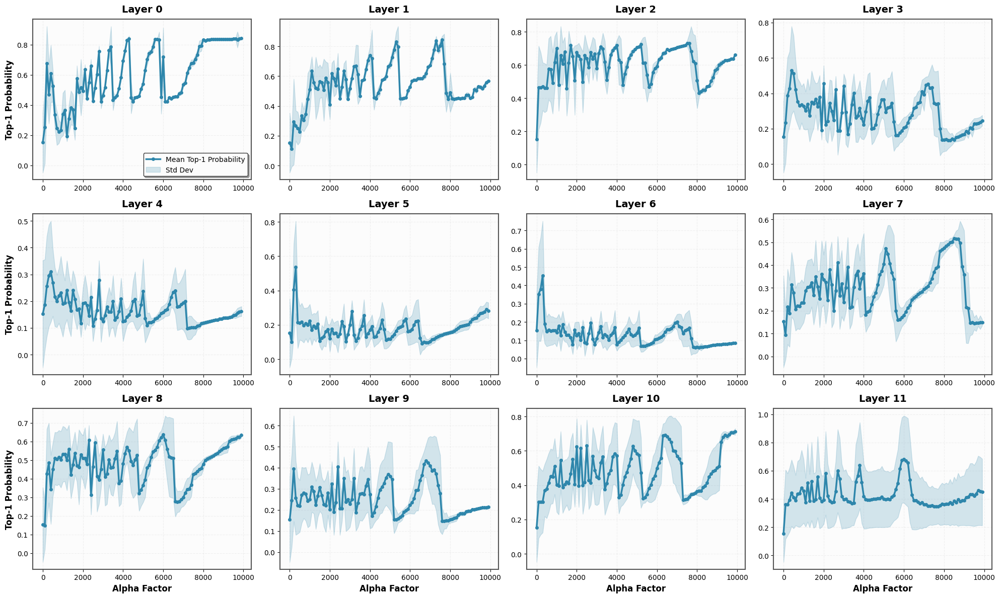

Layer 0:
  Mean range: [0.1531, 0.8423]
  Std range: [0.0000, 0.2454]
Layer 1:
  Mean range: [0.1127, 0.8465]
  Std range: [0.0004, 0.2880]
Layer 2:
  Mean range: [0.1531, 0.7329]
  Std range: [0.0022, 0.2518]
Layer 3:
  Mean range: [0.1344, 0.5295]
  Std range: [0.0147, 0.2490]
Layer 4:
  Mean range: [0.0975, 0.3107]
  Std range: [0.0042, 0.2001]
Layer 5:
  Mean range: [0.0918, 0.5352]
  Std range: [0.0107, 0.2692]
Layer 6:
  Mean range: [0.0609, 0.4546]
  Std range: [0.0029, 0.2969]
Layer 7:
  Mean range: [0.0929, 0.5160]
  Std range: [0.0130, 0.2001]
Layer 8:
  Mean range: [0.1487, 0.6357]
  Std range: [0.0095, 0.2415]
Layer 9:
  Mean range: [0.1458, 0.4331]
  Std range: [0.0057, 0.2505]
Layer 10:
  Mean range: [0.1531, 0.7112]
  Std range: [0.0101, 0.2135]
Layer 11:
  Mean range: [0.1531, 0.6812]
  Std range: [0.1230, 0.3142]


In [3]:
path_template = "../../assets/linearity/pythia-160m/norm_related_safety_layer{}.pt"
import torch
import numpy as np
import matplotlib.pyplot as plt

# Create a figure with subplots for all 12 layers
fig, axes = plt.subplots(3, 4, figsize=(20, 12))
axes = axes.flatten()

for layer_idx in range(12):
    path = path_template.format(layer_idx)
    norm_data = torch.load(path, weights_only=False)
    top1_probs = norm_data["top1_probs"]
    
    # Calculate mean and std across alpha values (axis=0)
    mean_top1_probs = np.mean(top1_probs, axis=1)
    std_top1_probs = np.std(top1_probs, axis=1)
    
    # Get alpha values (assuming they correspond to indices)
    alpha_values = np.arange(len(mean_top1_probs)) * 100
    
    ax = axes[layer_idx]
    
    # Plot mean with shaded std
    ax.plot(alpha_values, mean_top1_probs, linewidth=2.5, color='#2E86AB', 
            label='Mean Top-1 Probability', marker='o', markersize=4)
    ax.fill_between(alpha_values, 
                    mean_top1_probs - std_top1_probs, 
                    mean_top1_probs + std_top1_probs,
                    color='#2E86AB', alpha=0.2, label='Std Dev')
    
    # Enhanced styling
    ax.grid(True, alpha=0.25, linestyle='--', linewidth=0.8, color='#CCCCCC')
    ax.set_axisbelow(True)
    ax.set_title(f'Layer {layer_idx}', fontweight='bold', fontsize=14, pad=10)
    
    # Add x-label only for bottom row
    if layer_idx >= 8:
        ax.set_xlabel('Alpha Factor', fontweight='bold', fontsize=12)
    
    # Add y-label only for leftmost column
    if layer_idx % 4 == 0:
        ax.set_ylabel('Top-1 Probability', fontweight='bold', fontsize=12)
    
    # Spine styling
    for spine in ax.spines.values():
        spine.set_linewidth(1.5)
        spine.set_color('#555555')
    
    # Background
    ax.patch.set_facecolor('#FAFAFA')
    ax.patch.set_alpha(0.5)
    
    # Legend only for first subplot
    if layer_idx == 0:
        ax.legend(frameon=True, fancybox=True, shadow=True, framealpha=0.98, 
                 edgecolor='#333333', fontsize=10)

plt.tight_layout()
plt.savefig(f'../../assets/figs/linearity/pythia-160m_top1_probs_all_layers.pdf', 
            format='pdf', bbox_inches='tight', dpi=300)
plt.show()

# Print statistics for all layers
for layer_idx in range(12):
    path = path_template.format(layer_idx)
    norm_data = torch.load(path, weights_only=False)
    top1_probs = norm_data["top1_probs"]
    mean_top1_probs = np.mean(top1_probs, axis=1)
    std_top1_probs = np.std(top1_probs, axis=1)
    print(f"Layer {layer_idx}:")
    print(f"  Mean range: [{mean_top1_probs.min():.4f}, {mean_top1_probs.max():.4f}]")
    print(f"  Std range: [{std_top1_probs.min():.4f}, {std_top1_probs.max():.4f}]")